In [ ]:
# --- Local utilities  ---
from utils.imports import *
from utils.plotting import *
from utils.config import DEFAULT_CONFIG as cfg
from utils.binary import get_blackhole_binary
from utils.star import evolve_star, relax_sph_realization
from amuse.ext.sink import new_sink_particles

%reload_ext autoreload 
%autoreload 2
%matplotlib inline
quantity_support()

@contextlib.contextmanager
def suppress_print():
    with open(os.devnull, "w") as f, contextlib.redirect_stdout(f):
        yield

/home/snrts/miniforge3/envs/amuse/lib/python3.12/site-packages/amuse/support/options.py:11: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources


In [ ]:
%%time

def hydro_sink_particles(sinks, g):
    removed_particles = Particles()
    for s in sinks:
        xs,ys,zs=s.x,s.y,s.z
        radius_squared = (((s.mass)/(10|u.MSun))|u.RSun)**2
        insink=g.select_array(lambda x,y,z: (x-xs)**2+(y-ys)**2+(z-zs)**2 < radius_squared,['x','y','z'])  
        if len(insink)>0:
            print(len(insink))
            s.mass+=insink.total_mass()
            removed_particles.add_particles(insink)
    return removed_particles

# =============================================================================
# System construction
# =============================================================================
# --- Gravity ---

binary = read_set_from_file('data/setup/binary/m1=40m2=60a=0.2e=0.hdf5')
binary.position += [0,0.6, 0] | u.AU 
relgas = read_set_from_file('data/setup/star/relaxednew.hdf5')


converter_grav = nbody_system.nbody_to_si(binary.mass.sum(), 1|u.AU)
gravity = Ph4(converter_grav, mode="cpu_mode")
for k,v in cfg["Ph4"].items():
    setattr(gravity.parameters, k, v)
gravity.particles.add_particles(binary)

# --- Hydro ---
converter_hydro = nbody_system.nbody_to_si(1 | u.MSun, 1 | u.RSun)
hydro = Fi(converter_hydro)
hydro.gas_particles.add_particles(relgas)
# hydro.dm_particles.add_particles(core)
hydro.parameters.self_gravity_flag = True
hydro.parameters.use_hydro_flag =True
hydro.parameters.gamma=5.0/3.0
hydro.parameters.timestep = relgas.dynamical_timescale()/10

# for k,v in cfg["Fi"].items():
#     setattr(hydro.parameters, k, v)
channel_from_hydro = hydro.gas_particles.new_channel_to(relgas)

# --- Bridge ---
bridge = Bridge(use_threading=True)
bridge.add_system(gravity, (hydro,))
bridge.add_system(hydro, (gravity,))
bridge.timestep = 10*hydro.parameters.timestep

# --- Channels ---
# Gravity -> Hydro: positions/velocities (for kicks)
chan_grav_to_hy = gravity.particles.new_channel_to(hydro.gas_particles)

# Hydro -> Gravity: mass only (to reflect stripping/accretion)
chan_hy_to_grav = hydro.gas_particles.new_channel_to(gravity.particles)


time_step= bridge.timestep
time_end= 300*time_step
model_time = 0 | units.Myr
write_set_to_file([binary.savepoint(model_time), relgas.savepoint(model_time)],
                      "bridgetestn2.hdf5", 
                      'amuse', 
                      names=['binary', 'gas'],
                      overwrite_file=True)
accreted_gas = Particles()
while model_time < time_end:
    model_time += time_step
    bridge.evolve_model(model_time)
    print(f"{model_time/time_end} with end time {time_end}")
    accreted = hydro_sink_particles(gravity.particles, hydro.gas_particles)
    if len(accreted)>0:
            print("N accreted:", model_time.value_in(units.yr), len(accreted), \
                  "m=", accreted.mass.sum().in_(units.MSun))
            accreted_gas.add_particles(accreted.copy())
            relgas.remove_particles(accreted)
            hydro.gas_particles.remove_particles(accreted)
            
    
    gravity.particles.new_channel_to(binary).copy()
    hydro.gas_particles.new_channel_to(relgas).copy()
    write_set_to_file([binary.savepoint(model_time), relgas.savepoint(model_time)],
                      "bridgetestn2.hdf5", 
                      'amuse', 
                      names=['binary', 'gas'],
                      append_to_file=True)
bridge.stop()
gravity.stop()
hydro.stop()


0.0033333333333333335 with end time 6.6e+05s
0.006666666666666667 with end time 6.6e+05s
0.01 with end time 6.6e+05s
0.013333333333333334 with end time 6.6e+05s
0.01666666666666667 with end time 6.6e+05s
0.02 with end time 6.6e+05s
0.02333333333333333 with end time 6.6e+05s
0.026666666666666665 with end time 6.6e+05s
0.03 with end time 6.6e+05s
0.03333333333333333 with end time 6.6e+05s
0.03666666666666666 with end time 6.6e+05s
0.04 with end time 6.6e+05s
0.04333333333333333 with end time 6.6e+05s
0.04666666666666666 with end time 6.6e+05s
0.049999999999999996 with end time 6.6e+05s
0.05333333333333333 with end time 6.6e+05s
0.056666666666666664 with end time 6.6e+05s
0.06 with end time 6.6e+05s
0.06333333333333332 with end time 6.6e+05s
0.06666666666666667 with end time 6.6e+05s
0.06999999999999999 with end time 6.6e+05s
0.07333333333333332 with end time 6.6e+05s
0.07666666666666666 with end time 6.6e+05s
0.08 with end time 6.6e+05s
0.08333333333333331 with end time 6.6e+05s
0.086666

/tmp/ipykernel_308184/2718664230.py:18: MatplotlibDeprecationWarning: Passing label as a length 2 sequence when plotting a single dataset is deprecated in Matplotlib 3.9 and will error in 3.11.  To keep the current behavior, cast the sequence to string before passing.
  scatter_objs[key], = ax.plot(
/tmp/ipykernel_308184/2718664230.py:18: MatplotlibDeprecationWarning: Passing label as a length 0 sequence when plotting a single dataset is deprecated in Matplotlib 3.9 and will error in 3.11.  To keep the current behavior, cast the sequence to string before passing.
  scatter_objs[key], = ax.plot(


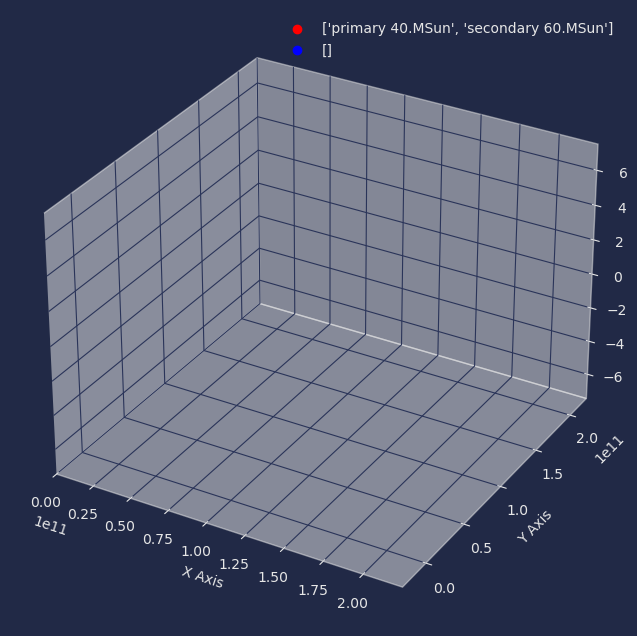

In [ ]:
file =  read_set_from_file("data/evolution/bridgetestn2 copy.hdf5")
lx,ly,lz = map(lambda i: i.as_astropy_quantity(), [(0,1.5)|u.AU, (-0.2,1.5)|u.AU, (-0.5, 0.5)|u.AU])
pad = 0.1 * max(lx[1]-lx[0], ly[1]-ly[0], lz[1]-lz[0])
color_map = {'binary': 'red', 'gas': 'blue', 'C': 'green'}

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection="3d")
ax.axis('equal')
ax.axes.set(
    xlabel= 'X Axis', ylabel='Y Axis', zlabel = 'Z Axis',
    xlim = lx, ylim=ly, zlim=lz )
# plt.axis("off")


scatter_objs = {}
for key in file.keys():
    
    scatter_objs[key], = ax.plot(
        [], [], [],"o",
        color=color_map[key], label=[f"{i.name} {i.mass}" for i in file[key] if not key=="gas"]
    )

ax.legend()

def init():
    for key in scatter_objs:
        scatter_objs[key].set_data([],[])
        scatter_objs[key].set_3d_properties([])
    
    return scatter_objs.values(),

def update(frame):
    for key in scatter_objs:
        state = file[key].get_state_at_timestamp(frame)
        x,y,z = state.position.as_astropy_quantity().T
        scatter_objs[key].set_data(x,y); scatter_objs[key].set_3d_properties(z)
    # ax.set_title(f"time {frame.value_in(u.s)}")
    return scatter_objs.values(),

# Create the animation

ani = FuncAnimation(
    fig, update, frames=[i.get_timestamp() for i in file['gas'].history],init_func=init, interval=100, blit=False
)
# Display animation inline
HTML(ani.to_jshtml())
